In [1]:
## Notebook env: cell2loc_env (cell2loc_env kernel)
## this notebook performs cell2location to *spatially* deconvolute cells using a reference annotated scRNAseq dataset

In [1]:
import sys
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import os

data_type = 'float32'

import cell2location

import matplotlib as mpl
from matplotlib import rcParams
import matplotlib.pyplot as plt
import seaborn as sns

# silence scanpy that prints a lot of warnings
import warnings
warnings.filterwarnings('ignore')

Global seed set to 0


In [2]:
results_folder = '/home/ssobti/projects/farnaz_spatial/output_data'

# create paths and names to results folders for reference regression and cell2location models
ref_run_name = f'{results_folder}/mouse/cell2location/multi_ref_annot/reference_signatures'
run_name = f'{results_folder}/mouse_late_2023/cell2location/multi_ref_annot/cell2location_map/N2_alpha20_cleaned_slides_v2'

In [3]:
adata_file = f"{run_name}/sp.h5ad"
adata_vis = sc.read_h5ad(adata_file)
mod = cell2location.models.Cell2location.load(f"{run_name}", adata_vis)

INFO     File                                                                                                      
         /home/ssobti/projects/farnaz_spatial/output_data/mouse_late_2023/cell2location/multi_ref_annot/cell2locati
         on_map/N2_alpha20_cleaned_slides_v2/model.pt already downloaded                                           


No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Epoch 1/30000:   0%|          | 1/30000 [00:18<157:41:51, 18.92s/it, v_num=1, elbo_train=1.91e+8]

`Trainer.fit` stopped: `max_steps=1` reached.


Epoch 1/30000:   0%|          | 1/30000 [00:18<157:51:26, 18.94s/it, v_num=1, elbo_train=1.91e+8]


In [4]:
### remove skeletal muscle probabilities from all samples
adata_vis.obsm['q05_cell_abundance_w_sf'] = adata_vis.obsm['q05_cell_abundance_w_sf'].drop('q05cell_abundance_w_sf_Skeletal_muscle', axis = 1)
adata_vis.uns['mod']['factor_names'] = adata_vis.uns['mod']['factor_names'][adata_vis.uns['mod']['factor_names'] != 'Skeletal_muscle']

### B006_3 polishing
## remove the spots completely from bottom right flap where low RNA counts
x = np.array(adata_vis.obs['array_col'])
y = np.array(adata_vis.obs['array_row'])
sample_identity = np.array(adata_vis.obs['sample'])

areas_to_discard1 = (x >= 167) & (x <= 190) & (y >= 50) & (y <= 100) & (sample_identity == 'B006_3')
areas_to_discard2 = (x >= 163) & (x <= 190) & (y >= 90) & (y <= 104) & (sample_identity == 'B006_3')
areas_to_discard = areas_to_discard1 | areas_to_discard2
adata_vis = adata_vis[~areas_to_discard]

## remove immune cells specifically above lymph nodes (ie set probabilities to 0)
x = np.array(adata_vis.obs['array_col'])
y = np.array(adata_vis.obs['array_row'])
sample_identity = np.array(adata_vis.obs['sample'])

areas_to_lower_prob_1 = (x >= 123) & (x <= 165) & (y >= 50) & (y <= 84) & (sample_identity == 'B006_3')
areas_to_lower_prob_2 = (x >= 165) & (x <= 167) & (y >= 50) & (y <= 88) & (sample_identity == 'B006_3')
areas_to_lower_probability = areas_to_lower_prob_1 | areas_to_lower_prob_2

area_to_lower_prob_df = adata_vis.obsm['q05_cell_abundance_w_sf'][areas_to_lower_probability]
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'B_cells'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'B_cells'] > 0.2] = 0.01
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Eosinophils'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Eosinophils'] > 0.06] = 0.01
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Epithelial_cells'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Epithelial_cells'] > 0.05] = 0.01
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Macrophages'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Macrophages'] > 0.075] = 0.01
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Mast_cells'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Mast_cells'] > 0.2] = 0.01
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Mesothelium'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Mesothelium'] > 0.04] = 0.01
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'NK_cells'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'NK_cells'] > 0.1] = 0.01
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Neutrophils'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Neutrophils'] > 0.15] = 0.01
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'T_cells'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'T_cells'] > 0.1] = 0.01
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Tregs'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Tregs'] > 0.1] = 0.01
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Lymphatic_endothelial_cells'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Lymphatic_endothelial_cells'] > 0.1] = 0.01
adata_vis.obsm['q05_cell_abundance_w_sf'][areas_to_lower_probability] = area_to_lower_prob_df


### A021_3 polishing
x = np.array(adata_vis.obs['array_col'])
y = np.array(adata_vis.obs['array_row'])
sample_identity = np.array(adata_vis.obs['sample'])
area_to_lower_prob_df = adata_vis.obsm['q05_cell_abundance_w_sf'][sample_identity == 'A021_3']
area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Adipocyte_progenitors'][area_to_lower_prob_df['q05cell_abundance_w_sf_' + 'Adipocyte_progenitors'] > 0.15] = 0.01
adata_vis.obsm['q05_cell_abundance_w_sf'][sample_identity == 'A021_3'] = area_to_lower_prob_df

In [5]:
## save csv of probabilities without spots in lower right bottom
## make sure to remove all spots not present in csv above when you load up slides ie (slide = slide[spots in csv])
adata_vis.obsm['q05_cell_abundance_w_sf'].to_csv(f"{run_name}/q05_cell_abundance_w_sf.csv")
adata_vis.obs

,in_tissue,array_row,array_col,sample,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,mt_frac,_indices,_scvi_batch,_scvi_labels
spot_id,,,,,,,,,,,,,,,,
B006_3_AACAATCCGAGTGGAC-1,1,103,47,B006_3,253,5.537334,281.0,5.641907,27.758007,45.551601,81.138790,100.000000,0.0,0,0,0
B006_3_AACAATGGAACCACAT-1,1,54,32,B006_3,822,6.712956,1059.0,6.966024,23.040604,31.822474,41.265345,69.593957,0.0,1,0,0
B006_3_AACAATGTGCTCCGAG-1,1,98,158,B006_3,1283,7.157735,1897.0,7.548556,21.349499,29.362151,40.274117,58.724302,0.0,2,0,0
B006_3_AACACCAGCCTACTCG-1,1,31,39,B006_3,872,6.771936,1134.0,7.034388,21.516755,30.335097,40.740741,67.195767,0.0,3,0,0
B006_3_AACACCGAGCTTGGAT-1,1,56,24,B006_3,565,6.338594,655.0,6.486161,21.374046,29.007634,44.274809,90.076336,0.0,4,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
B021_6_TGTTGGTGAGCGGACG-1,1,59,17,B021_6,986,6.894670,1143.0,7.042286,15.223097,22.484689,31.233596,57.480315,0.0,44195,5,0
B021_6_TGTTGGTGCGCACGAG-1,1,24,108,B021_6,646,6.472346,817.0,6.706862,23.745410,33.170135,45.410037,82.129743,0.0,44196,5,0
B021_6_TGTTGGTGCGCTTCGC-1,1,37,127,B021_6,859,6.756932,1184.0,7.077498,25.168919,33.614865,44.341216,69.679054,0.0,44197,5,0


In [6]:
## select best display maxes for each cell type
## find the 99th percentile(s) for each slide in a each cell type (make table of it -- cell types are rows and slides are columns)

adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']
sample_annotated_cell_probs = adata_vis.obs[['sample'] + list(adata_vis.uns['mod']['factor_names'])]
tbl_99pctile = sample_annotated_cell_probs.groupby(['sample']).quantile(0.99)
min_max_means_of_99pctile = [np.mean(x) for x in zip(tbl_99pctile.min(axis = 0), tbl_99pctile.max(axis = 0))]

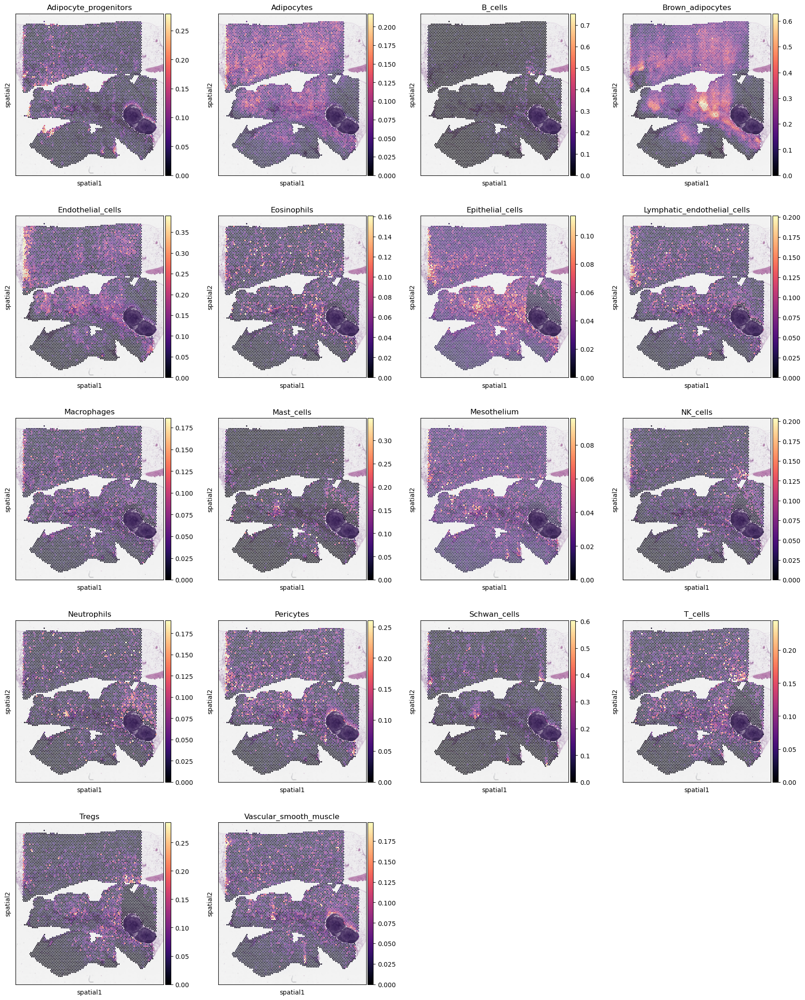

In [7]:
# add 5% quantile, representing confident cell abundance, 'at least this amount is present',
# to adata.obs with nice names for plotting
## samples are B006_3, A021_3, A006_3, A041_6, B041_6, B021_6
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

# select one slide
from cell2location.utils import select_slide
slide = select_slide(adata_vis, 'B006_3') ## slide name to select here

# plot in spatial coordinates
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(adata_vis.uns['mod']['factor_names']),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=min_max_means_of_99pctile, show = False
                 )
    plt.savefig('/home/ssobti/projects/farnaz_spatial/output_data/mouse_late_2023/cell2location/other_outputs/N2_alpha20_cleaned_slides_B006_3_v2.pdf', bbox_inches="tight")

In [8]:
# add 5% quantile, representing confident cell abundance, 'at least this amount is present',
# to adata.obs with nice names for plotting
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

# select one slide
from cell2location.utils import select_slide
slide = select_slide(adata_vis, 'A021_3') ## slide name to select here

# plot in spatial coordinates
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(adata_vis.uns['mod']['factor_names']),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=min_max_means_of_99pctile, show = False
                 )
    plt.savefig('/home/ssobti/projects/farnaz_spatial/output_data/mouse_late_2023/cell2location/other_outputs/N2_alpha20_cleaned_slides_A021_3_v2.pdf', bbox_inches="tight")

In [12]:
# add 5% quantile, representing confident cell abundance, 'at least this amount is present',
# to adata.obs with nice names for plotting
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

# select one slide
from cell2location.utils import select_slide
slide = select_slide(adata_vis, 'A006_3') ## slide name to select here

# plot in spatial coordinates
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(adata_vis.uns['mod']['factor_names']),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=min_max_means_of_99pctile, show = False
                 )
    plt.savefig('/home/ssobti/projects/farnaz_spatial/output_data/mouse_late_2023/cell2location/other_outputs/N2_alpha20_cleaned_slides_A006_3_v2.pdf', bbox_inches="tight")

In [13]:
# add 5% quantile, representing confident cell abundance, 'at least this amount is present',
# to adata.obs with nice names for plotting
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

# select one slide
from cell2location.utils import select_slide
slide = select_slide(adata_vis, 'A041_6') ## slide name to select here

# plot in spatial coordinates
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(adata_vis.uns['mod']['factor_names']),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=min_max_means_of_99pctile, show = False
                 )
    plt.savefig('/home/ssobti/projects/farnaz_spatial/output_data/mouse_late_2023/cell2location/other_outputs/N2_alpha20_cleaned_slides_A041_6_v2.pdf', bbox_inches="tight")

In [14]:
# add 5% quantile, representing confident cell abundance, 'at least this amount is present',
# to adata.obs with nice names for plotting
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

# select one slide
from cell2location.utils import select_slide
slide = select_slide(adata_vis, 'B041_6') ## slide name to select here

# plot in spatial coordinates
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(adata_vis.uns['mod']['factor_names']),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=min_max_means_of_99pctile, show = False
                 )
    plt.savefig('/home/ssobti/projects/farnaz_spatial/output_data/mouse_late_2023/cell2location/other_outputs/N2_alpha20_cleaned_slides_B041_6_v2.pdf', bbox_inches="tight")

In [15]:
# add 5% quantile, representing confident cell abundance, 'at least this amount is present',
# to adata.obs with nice names for plotting
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

# select one slide
from cell2location.utils import select_slide
slide = select_slide(adata_vis, 'B021_6') ## slide name to select here

# plot in spatial coordinates
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):

    sc.pl.spatial(slide, cmap='magma',
                  # show first 8 cell types
                  color=list(adata_vis.uns['mod']['factor_names']),
                  ncols=4, size=1.3,
                  img_key='hires',
                  # limit color scale at 99.2% quantile of cell abundance
                  vmin=0, vmax=min_max_means_of_99pctile, show = False
                 )
    plt.savefig('/home/ssobti/projects/farnaz_spatial/output_data/mouse_late_2023/cell2location/other_outputs/N2_alpha20_cleaned_slides_B021_6_v2.pdf', bbox_inches="tight")

In [16]:
# compute KNN using the cell2location output stored in adata.obsm
sc.pp.neighbors(adata_vis, use_rep='q05_cell_abundance_w_sf',
                n_neighbors = 15)

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_vis, resolution=1.1)

# add region as categorical variable
adata_vis.obs["region_cluster"] = adata_vis.obs["leiden"].astype("category")

<Figure size 450x500 with 0 Axes>

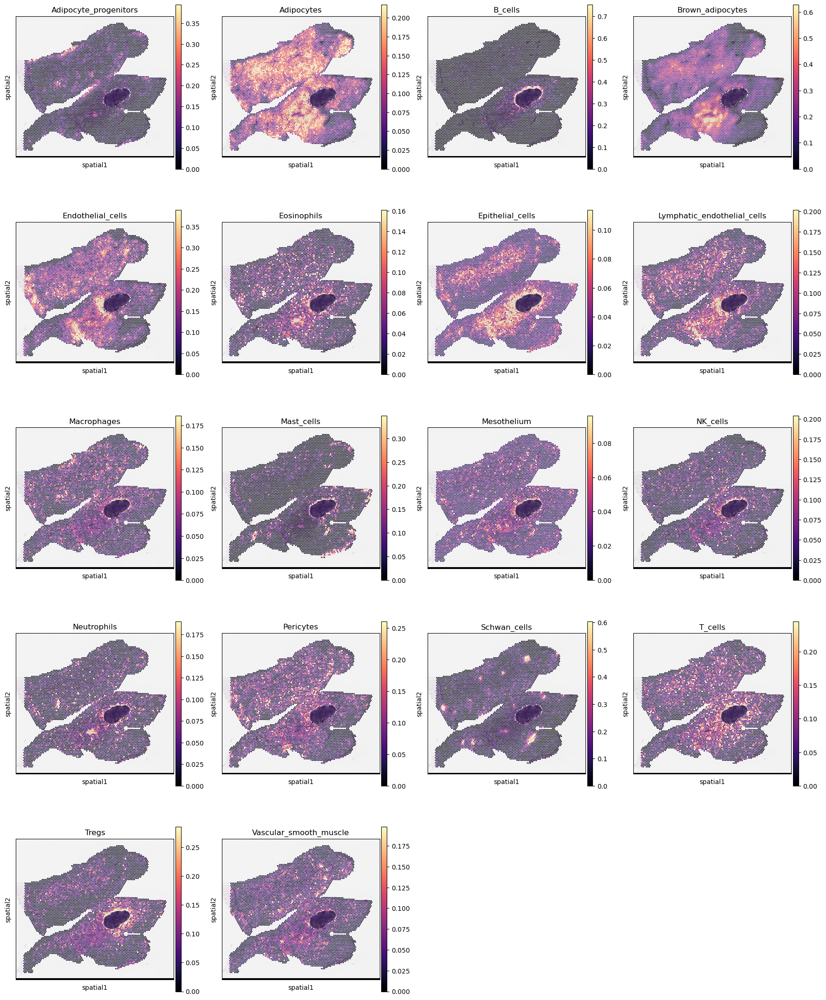

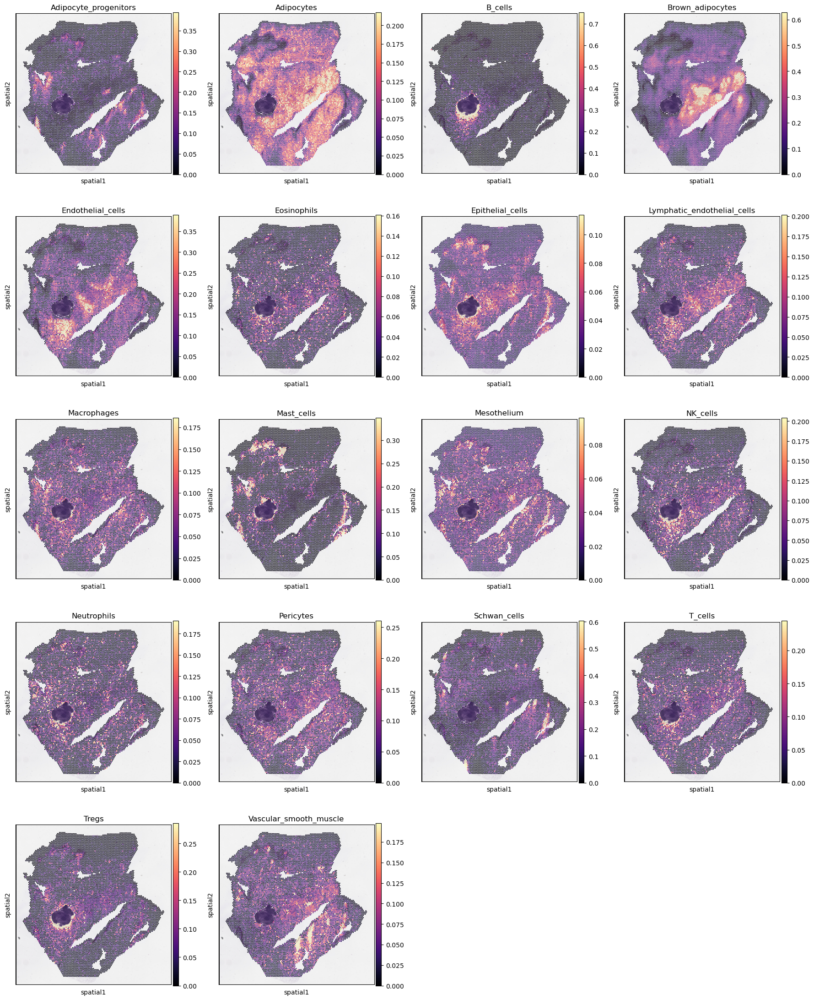

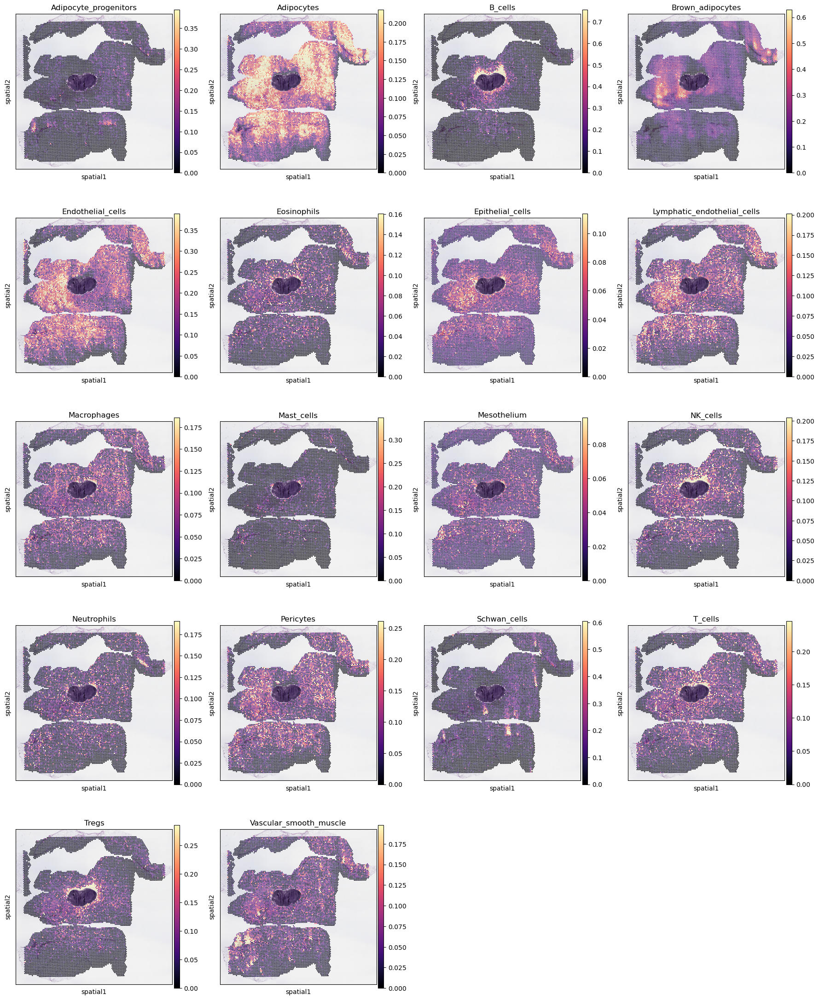

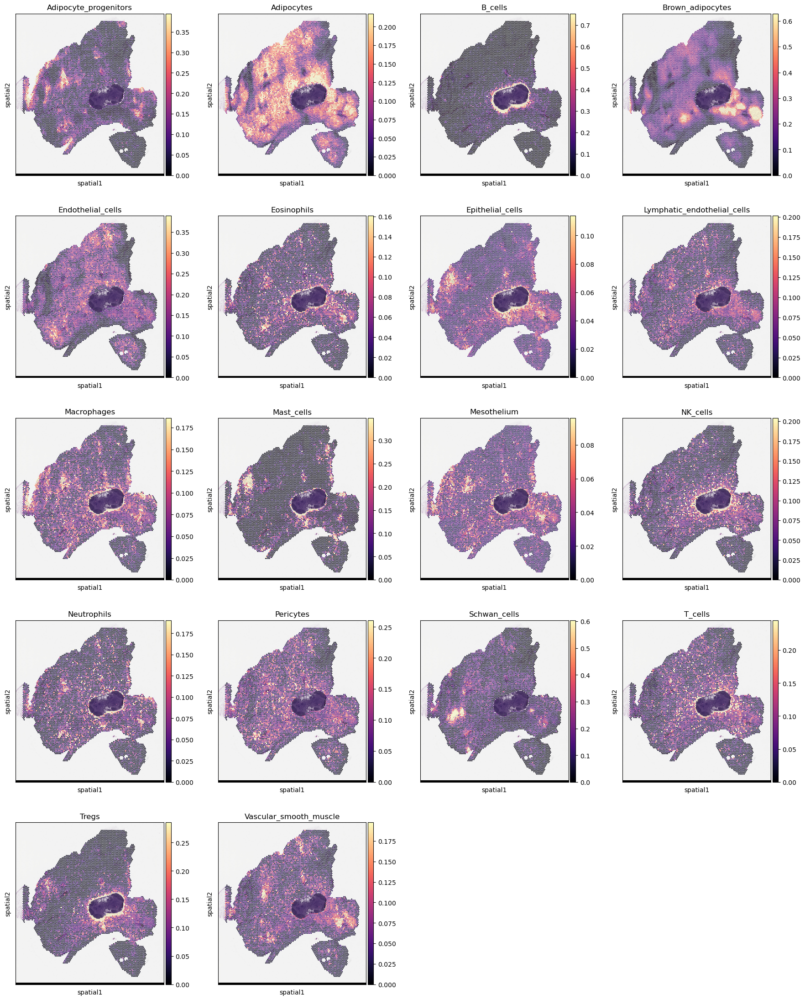

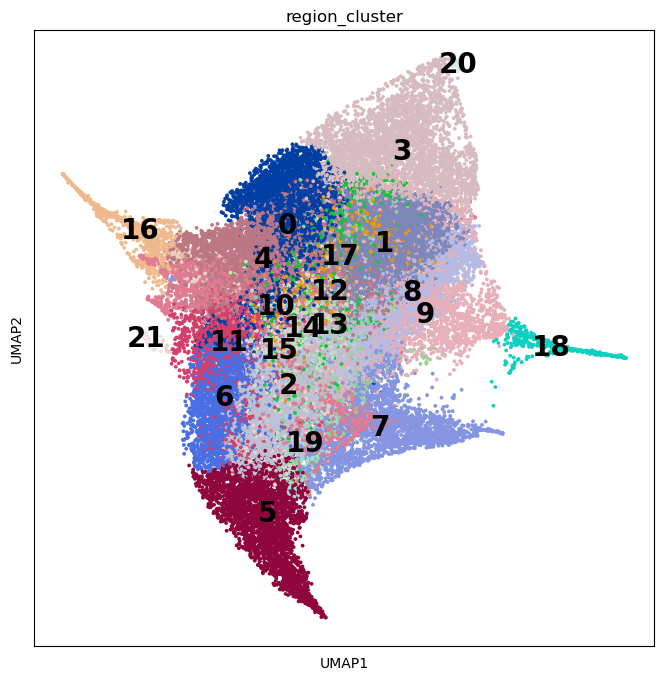

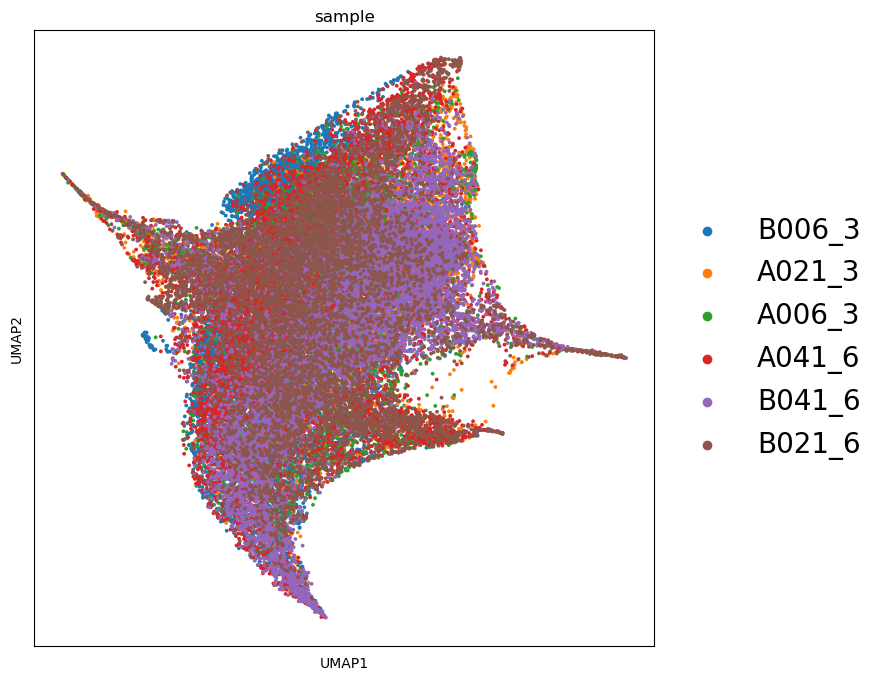

In [17]:
# compute UMAP using KNN graph based on the cell2location output
sc.tl.umap(adata_vis, min_dist = 0.3, spread = 1)

# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [8, 8]}):
    sc.pl.umap(adata_vis, color=['region_cluster'], size=30,
               color_map = 'RdPu', ncols = 2, legend_loc='on data',
               legend_fontsize=20)
    sc.pl.umap(adata_vis, color=['sample'], size=30,
               color_map = 'RdPu', ncols = 2,
               legend_fontsize=20)

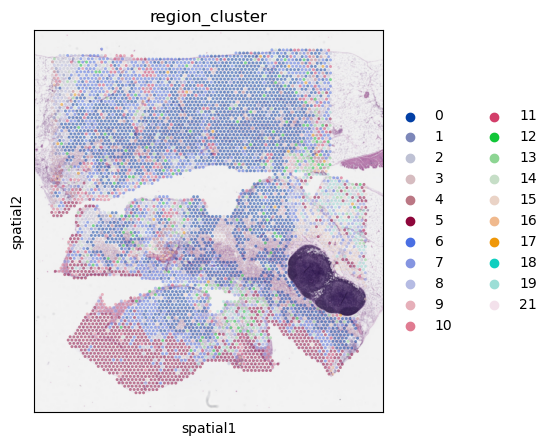

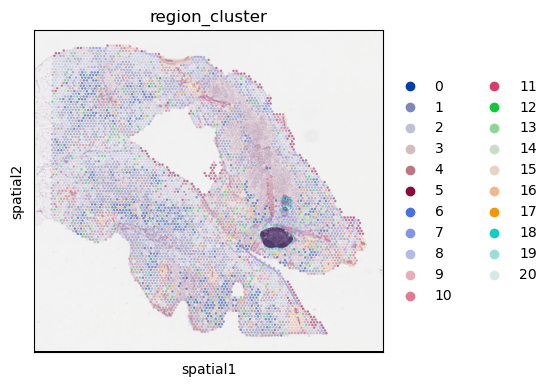

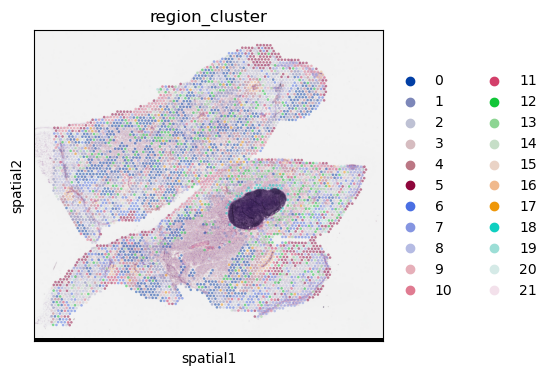

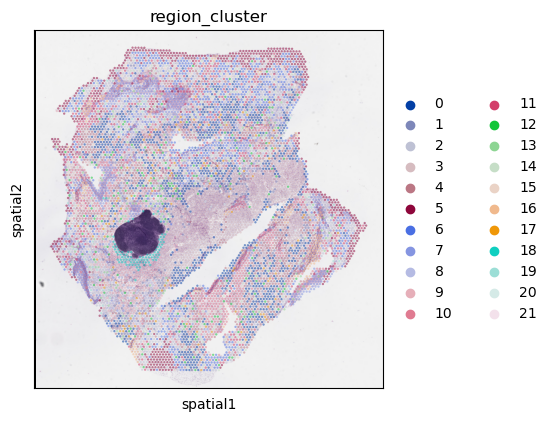

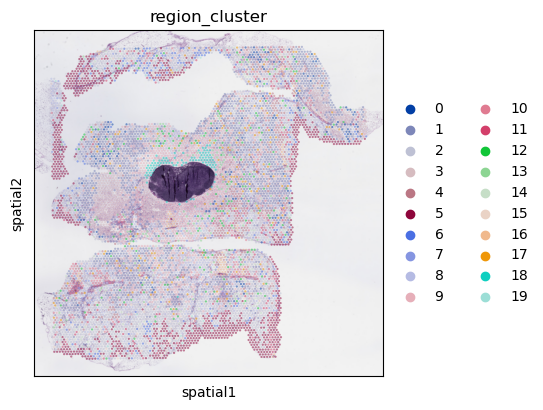

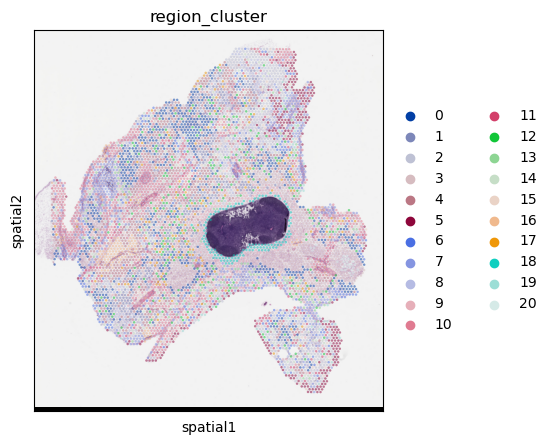

In [18]:
# plot in spatial coordinates 
with mpl.rc_context({'axes.facecolor':  'black',
                     'figure.figsize': [4.5, 5]}):
    sc.pl.spatial(select_slide(adata_vis, 'B006_3'), color=['region_cluster'],
                  size=1.3, img_key='hires', alpha=0.5, library_id='B006_3')
    sc.pl.spatial(select_slide(adata_vis, 'A021_3'), color=['region_cluster'],
                  size=1.3, img_key='hires', alpha=0.5, library_id='A021_3')
    sc.pl.spatial(select_slide(adata_vis, 'A006_3'), color=['region_cluster'],
                  size=1.3, img_key='hires', alpha=0.5, library_id='A006_3')
    sc.pl.spatial(select_slide(adata_vis, 'A041_6'), color=['region_cluster'],
                  size=1.3, img_key='hires', alpha=0.5, library_id='A041_6')
    sc.pl.spatial(select_slide(adata_vis, 'B041_6'), color=['region_cluster'],
                  size=1.3, img_key='hires', alpha=0.5, library_id='B041_6')
    sc.pl.spatial(select_slide(adata_vis, 'B021_6'), color=['region_cluster'],
                  size=1.3, img_key='hires', alpha=0.5, library_id='B021_6')

## NMF

In [16]:
from cell2location import run_colocation
res_dict, slide = run_colocation(
    adata_vis,
    model_name='CoLocatedGroupsSklearnNMF',
    train_args={
      'n_fact': np.arange(5, 30), # IMPORTANT: use a wider range of the number of factors (5-30)
      'sample_name_col': 'sample', # columns in adata_vis.obs that identifies sample
      'n_restarts': 3 # number of training restarts
    },
    # the hyperparameters of NMF can be also adjusted:
    model_kwargs={'alpha': 0.01, 'init': 'random', "nmf_kwd_args": {"tol": 0.000001}},
    export_args={'path': f'{run_name}/CoLocatedComb/'}
)

### Analysis name: CoLocatedGroupsSklearnNMF_5combinations_44200locations_19factors


ValueError: The condensed distance matrix must contain only finite values.

In [17]:
# Compute expected expression per cell type
expected_dict = mod.module.model.compute_expected_per_cell_type(
    mod.samples["post_sample_q05"], mod.adata_manager
)

AttributeError: 'Cell2location' object has no attribute 'samples'